#  Object Detection in Aerial Images using DETR

## Part 2 - Fine-tuning and Evaluation

-----------------------------------

**DETR** (DEtection TRansformer) approaches object detection as a direct set prediction problem. It consists of a set-based global loss, which forces unique predictions via bipartite matching, and a **Transformer encoder-decoder** architecture. Given a fixed small set of learned object queries, DETR reasons about the relations of the objects and the global image context to directly output the final set of predictions in parallel. Due to this parallel nature, DETR is very fast and efficient.

<p align='center'>
<img src='https://raw.githubusercontent.com/facebookresearch/detr/main/.github/DETR.png' />
</p>

We have many versions for DETR model:

<table>
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>name</th>
      <th>backbone</th>
      <th>schedule</th>
      <th>inf_time</th>
      <th>box AP</th>
      <th>url</th>
      <th>size</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>DETR</td>
      <td>R50</td>
      <td>500</td>
      <td>0.036</td>
      <td>42.0</td>
      <td><a href="https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth">model</a></td>
      <td>159Mb</td>
    </tr>
    <tr>
      <th>1</th>
      <td>DETR-DC5</td>
      <td>R50</td>
      <td>500</td>
      <td>0.083</td>
      <td>43.3</td>
      <td><a href="https://dl.fbaipublicfiles.com/detr/detr-r50-dc5-f0fb7ef5.pth">model</a></td>
      <td>159Mb</td>
    </tr>
    <tr>
      <th>2</th>
      <td>DETR</td>
      <td>R101</td>
      <td>500</td>
      <td>0.050</td>
      <td>43.5</td>
      <td><a href="https://dl.fbaipublicfiles.com/detr/detr-r101-2c7b67e5.pth">model</a></td>
      <td>232Mb</td>
    </tr>
    <tr>
      <th>3</th>
      <td>DETR-DC5</td>
      <td>R101</td>
      <td>500</td>
      <td>0.097</td>
      <td>44.9</td>
      <td><a href="https://dl.fbaipublicfiles.com/detr/detr-r101-dc5-a2e86def.pth">model</a></td>
      <td>232Mb</td>
    </tr>
  </tbody>
</table>

For demo purposes, we will just use **DETR-ResNet50** version.

**Note.** 
- In order to fine tune the [original DETR implementation](https://github.com/facebookresearch/detr/) of Facebook, we will build the model and replace its head architecture corresponding to the number of class in our dataset. After that, we need to remove the head part of the pre-trained weights before loading it into the model. By following this way, we will have to code the training function ourselves. You can check it out at [this comment](https://github.com/facebookresearch/detr/issues/9#issuecomment-636391562).
- This tutorial is based on [this repo](https://github.com/woctezuma/finetune-detr). The author of its has made a fork of original version to help us fine tune this model in an easier way:
    - They allow us to provide the number of class in advanced.
    - All the thing we need to do is just running the training command. For example:
    ```bash
        !python main.py --coco_path '...' --num_class '...' --epochs '...'
    ```
    - You can see the differences in codes at [this link](https://github.com/facebookresearch/detr/compare/main...woctezuma:detr:finetune).

Ok, let's get started!


In [ ]:
!pip install -q pycocotools

### 1. Visualize the dataset

In part 1 of this tutorial, we have processed the DOTA data to have a COCO format version of it. Let's visualize some annotaions (horizontal bounding boxes) of images in validation set:

In [ ]:
from pycocotools.coco import COCO

ROOT = '/kaggle/input/dota-coco'
anns_path = f'{ROOT}/annotations/custom_val.json'
coco = COCO(anns_path)

categories = [cat['name'] for cat in coco.loadCats(coco.getCatIds())]
img_ids = coco.getImgIds()
print(categories)

loading annotations into memory...
Done (t=0.26s)
creating index...
index created!
['plane', 'baseball-diamond', 'bridge', 'ground-track-field', 'small-vehicle', 'large-vehicle', 'ship', 'tennis-court', 'basketball-court', 'storage-tank', 'soccer-ball-field', 'roundabout', 'harbor', 'swimming-pool', 'helicopter']


In [ ]:
import matplotlib.pyplot as plt
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon
import cv2
import numpy as np

CLASSES = {}
for i in range(len(categories)):
    CLASSES[i+1] = categories[i]

def draw_box(img, anns, probs=None):
    if type(img) is str:
        img = cv2.imread(img)
    
    plt.figure(figsize=(20, 20))
    plt.imshow(img)
    plt.axis('off')

    ax = plt.gca()
    ax.set_autoscale_on(False)
    polygons = []
    color = []
    for i, ann in enumerate(anns):
        c = (np.random.random((1, 3)) * 0.6 + 0.4).tolist()[0]
        x_min, y_min, width, height = ann['bbox']
        cls = int(ann['category_id'])
        poly = [(x_min, y_min), (x_min, y_min + height), (x_min + width, y_min + height), (x_min + width, y_min)]
        polygons.append(Polygon(poly))
        color.append(c)
        point = poly[0]
        if probs is None:
            plt.text(point[0], point[1] - 2, CLASSES[cls], color=c, fontsize=10)
        else:
#             prob = np.round(probs[i], 2)
            plt.text(point[0], point[1] - 2, '{}: {:.2f}'.format(CLASSES[cls], probs[i]), color=c, fontsize=10)

    p = PatchCollection(polygons, facecolors=color, linewidths=0, alpha=0.4)
    ax.add_collection(p)
    p = PatchCollection(polygons, facecolors='none', edgecolors=color, linewidths=1)
    ax.add_collection(p)

def visualize(img_id):
    img_obj = coco.loadImgs(img_id)[0]
    img_name = img_obj['file_name']
    img_path = f'{ROOT}/val2017/{img_name}'

    print('Image name: {}'.format(img_name))
    draw_box(img_path, coco.loadAnns(coco.getAnnIds(imgIds=img_id)))

Image name: P2126__0.5__0___0.png


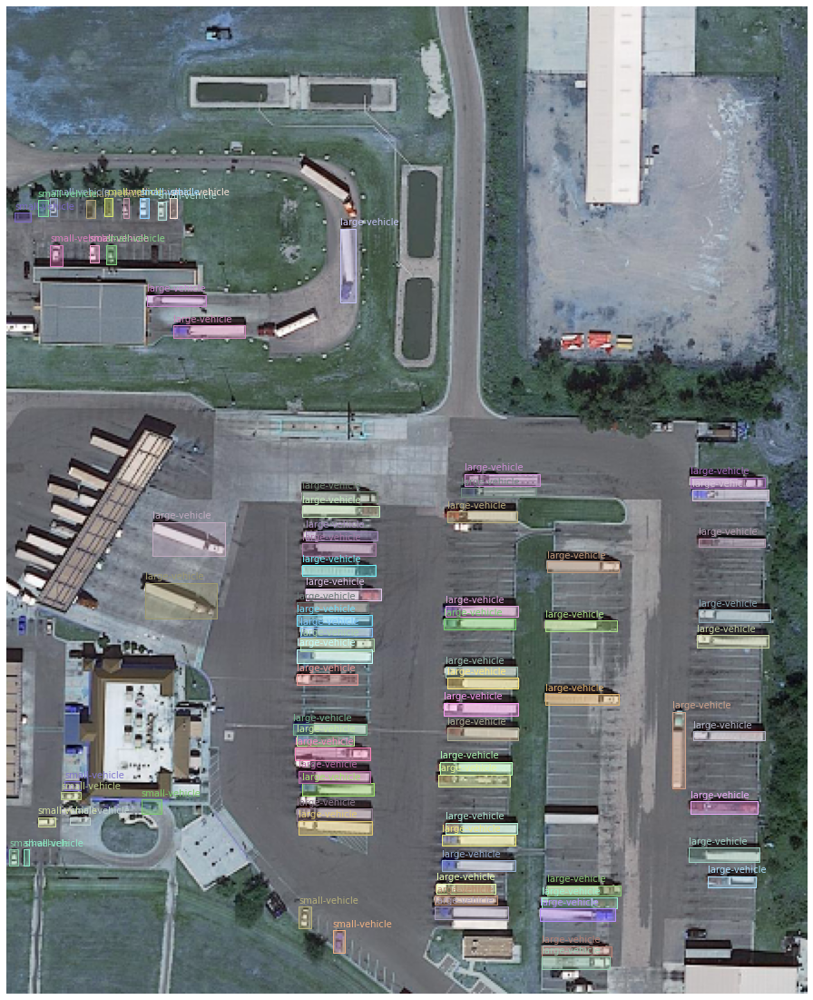

In [ ]:
visualize(100)

Image name: P0822__0.5__0___0.png


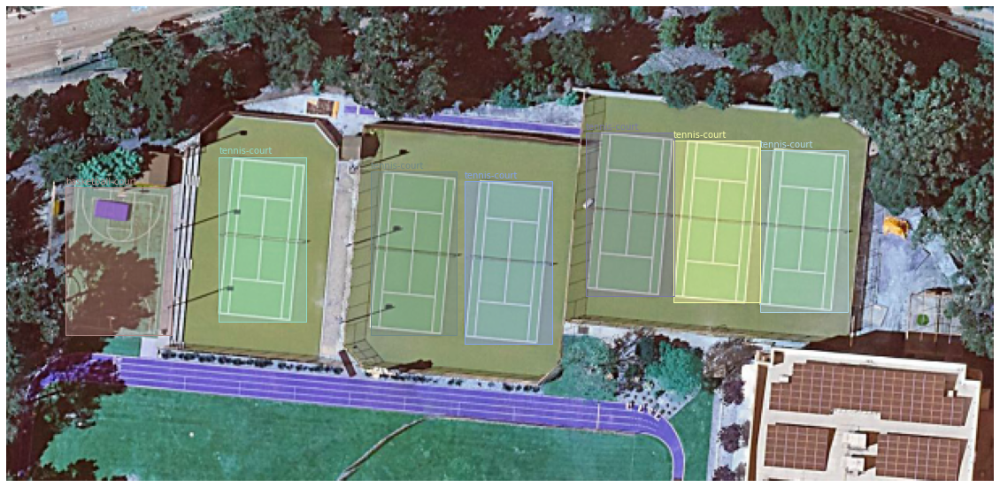

In [ ]:
visualize(600)

### 2. Clone the repo and modify pre-trained weights

In [ ]:
!rm -rf ./detr
!git clone https://github.com/woctezuma/detr.git
%cd ./detr/
!git checkout finetune

Cloning into 'detr'...
remote: Enumerating objects: 260, done.
remote: Total 260 (delta 0), reused 0 (delta 0), pack-reused 260
Receiving objects: 100% (260/260), 323.67 KiB | 938.00 KiB/s, done.
Resolving deltas: 100% (124/124), done.
/kaggle/working/detr
Branch 'finetune' set up to track remote branch 'finetune' from 'origin'.
Switched to a new branch 'finetune'


As mentioned before, we will user **DETR-ResNet50** version. For other version, you can find the download link of its pre-trained weights in the table at the heading of this notebook.

In [ ]:
import torch

# Get pretrained weights
checkpoint = torch.hub.load_state_dict_from_url(
            url='https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth',
            map_location='cpu',
            check_hash=True)

# Remove class weights
del checkpoint["model"]["class_embed.weight"]
del checkpoint["model"]["class_embed.bias"]

# Save
torch.save(checkpoint,
           'detr-r50_no-class-head.pth')

Downloading: "https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth" to /root/.cache/torch/hub/checkpoints/detr-r50-e632da11.pth


  0%|          | 0.00/159M [00:00<?, ?B/s]

### 3. Training

Firstly, the value of hyperparameter `num_class` is actually the ID which DETR will reserve for **its own** `no_object` class. It should be set to one plus the highest class ID in your dataset.

The dataset DOTA-v1.0 we are using has 15 classes, so `num_class = 15 + 1 = 16`.

Reference: https://github.com/facebookresearch/detr/issues/108#issuecomment-650269223

In [ ]:
num_classes = len(CLASSES) + 1
num_classes

16

Let's training! We also have many other hyperparameters in the following command. You can check it out at [this file](https://github.com/woctezuma/detr/blob/finetune/main.py).

**WARNING.**  The training process will print out **many many** lines of log :)

In [ ]:
!python main.py \
  --dataset_file "custom" \
  --coco_path $ROOT \
  --output_dir "outputs" \
  --resume "detr-r50_no-class-head.pth" \
  --num_classes $num_classes \
  --epochs 50 \
  --batch_size 4

Not using distributed mode
git:
  sha: 3cda3529921efb8870d0b49db7b30aa8477ae359, status: clean, branch: finetune

Namespace(aux_loss=True, backbone='resnet50', batch_size=4, bbox_loss_coef=5, clip_max_norm=0.1, coco_panoptic_path=None, coco_path='/kaggle/input/dota-coco', dataset_file='custom', dec_layers=6, device='cuda', dice_loss_coef=1, dilation=False, dim_feedforward=2048, dist_url='env://', distributed=False, dropout=0.1, enc_layers=6, eos_coef=0.1, epochs=50, eval=False, frozen_weights=None, giou_loss_coef=2, hidden_dim=256, lr=0.0001, lr_backbone=1e-05, lr_drop=200, mask_loss_coef=1, masks=False, nheads=8, num_classes=16, num_queries=100, num_workers=2, output_dir='outputs', position_embedding='sine', pre_norm=False, remove_difficult=False, resume='detr-r50_no-class-head.pth', seed=42, set_cost_bbox=5, set_cost_class=1, set_cost_giou=2, start_epoch=0, weight_decay=0.0001, world_size=1)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torc

When the training be done, this is the `outputs` folder we get:

In [ ]:
%ls outputs/

checkpoint.pth  eval/  log.txt


We can monitor the training process by these following cells. 

**Note**. Let's take a look at [this repo](https://github.com/woctezuma/finetune-detr) to have a better understanding about the meaning of values.

In [ ]:
from util.plot_utils import plot_logs

from pathlib import Path

log_directory = [Path('outputs/')]

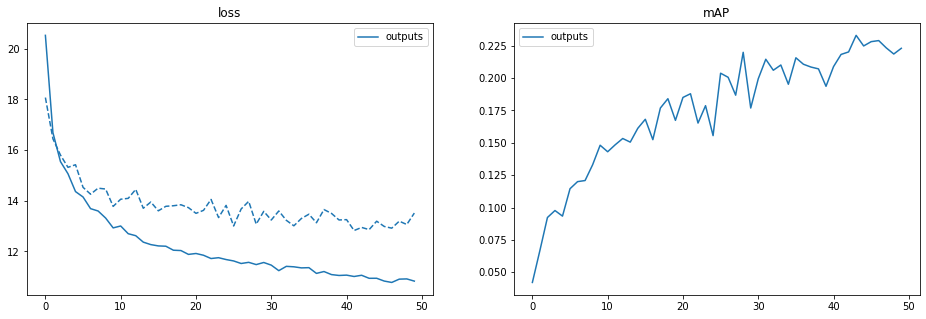

In [ ]:
fields_of_interest = (
    'loss',
    'mAP',
    )

plot_logs(log_directory,
          fields_of_interest)

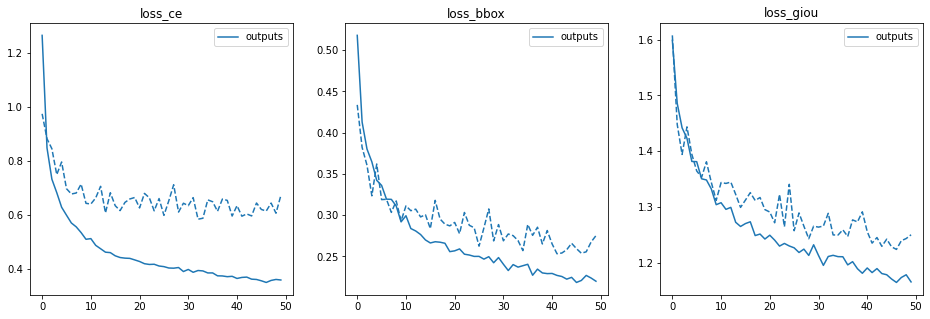

In [ ]:
fields_of_interest = (
    'loss_ce',
    'loss_bbox',
    'loss_giou',
    )

plot_logs(log_directory,
          fields_of_interest)

### 4. Evaluation

We can evaluate the trained model on the validation set by running the following cell. As the result, we get **mAP@.5 = 0.223**

In [ ]:
%%time
!python main.py \
  --dataset_file "custom" \
  --coco_path $ROOT \
  --output_dir "outputs" \
  --resume "outputs/checkpoint.pth" \
  --num_classes $num_classes \
  --eval \
  --batch_size 4

Not using distributed mode
git:
  sha: 3cda3529921efb8870d0b49db7b30aa8477ae359, status: clean, branch: finetune

Namespace(aux_loss=True, backbone='resnet50', batch_size=4, bbox_loss_coef=5, clip_max_norm=0.1, coco_panoptic_path=None, coco_path='/kaggle/input/dota-coco', dataset_file='custom', dec_layers=6, device='cuda', dice_loss_coef=1, dilation=False, dim_feedforward=2048, dist_url='env://', distributed=False, dropout=0.1, enc_layers=6, eos_coef=0.1, epochs=300, eval=True, frozen_weights=None, giou_loss_coef=2, hidden_dim=256, lr=0.0001, lr_backbone=1e-05, lr_drop=200, mask_loss_coef=1, masks=False, nheads=8, num_classes=16, num_queries=100, num_workers=2, output_dir='outputs', position_embedding='sine', pre_norm=False, remove_difficult=False, resume='outputs/checkpoint.pth', seed=42, set_cost_bbox=5, set_cost_class=1, set_cost_giou=2, start_epoch=0, weight_decay=0.0001, world_size=1)
number of params: 41283093
loading annotations into memory...
Done (t=0.93s)
creating index...
in

### 5. Visualization

We will load the weights from our checkpoint and make prediction on some images.

**NOTE**. In this section, we just make prediction on **patches**, not the original images. For THE inference on very large images, let's take a look at Part 3.

In [ ]:
model = torch.hub.load('facebookresearch/detr',
                       'detr_resnet50',
                       pretrained=False,
                       num_classes=num_classes)

checkpoint = torch.load('outputs/checkpoint.pth',
                        map_location='cpu')

model.load_state_dict(checkpoint['model'],
                      strict=False)

model = model.eval()

In [ ]:
import torchvision.transforms as T

# standard PyTorch mean-std input image normalization
transform = T.Compose([
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [ ]:
# for output bounding box post-processing
# from [x_c, y_c, w, h] to [xmin, ymin, xmax, ymax]
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)


def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b.detach().numpy()

def filter_bboxes_from_outputs(pil_img, outputs, threshold=0.7):
    # keep only predictions with confidence above threshold
    probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > threshold

    probas_to_keep = probas[keep].detach().numpy()

    # convert boxes from [0; 1] to image scales
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], pil_img.size)
    
    return probas_to_keep, bboxes_scaled


def plot_finetuned_results(pil_img, prob=None, boxes=None):
    cv2_img = np.array(pil_img.convert('RGB'))
    anns = []
    probs = []
    if prob is not None and boxes is not None:
        for p, (x_min, y_min, x_max, y_max) in zip(prob, boxes.tolist()):
            cl = p.argmax()
            anns.append({
                'bbox': [x_min, y_min, x_max - x_min, y_max - y_min],
                'category_id': cl
            })
            probs.append(np.round(p.max(), 2))
    draw_box(cv2_img, anns, probs)
    
def show_predictions(pil_image, my_model, threshold=0.2):
    # mean-std normalize the input image (batch-size: 1)
    img = transform(pil_image).unsqueeze(0)

    # propagate through the model
    outputs = my_model(img)

    probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(pil_image, outputs, threshold=threshold)
    plot_finetuned_results(pil_image, probas_to_keep, bboxes_scaled)


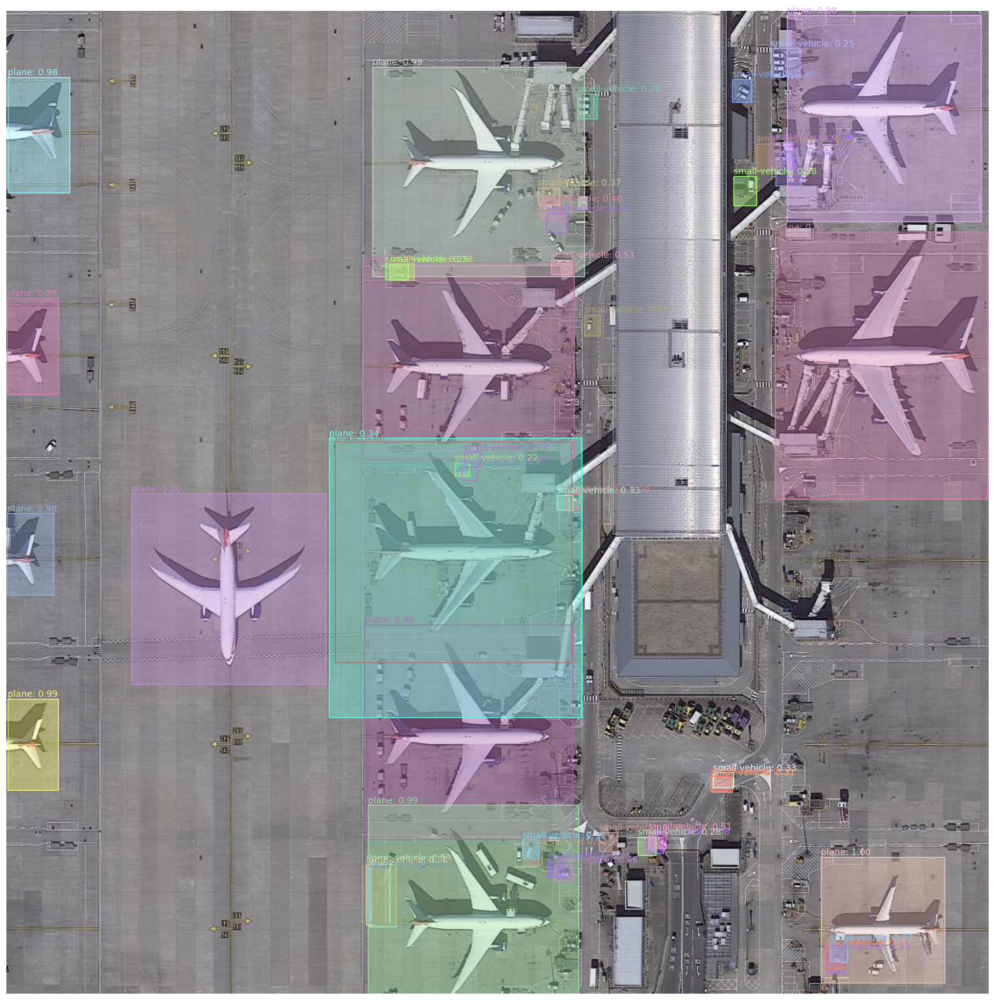

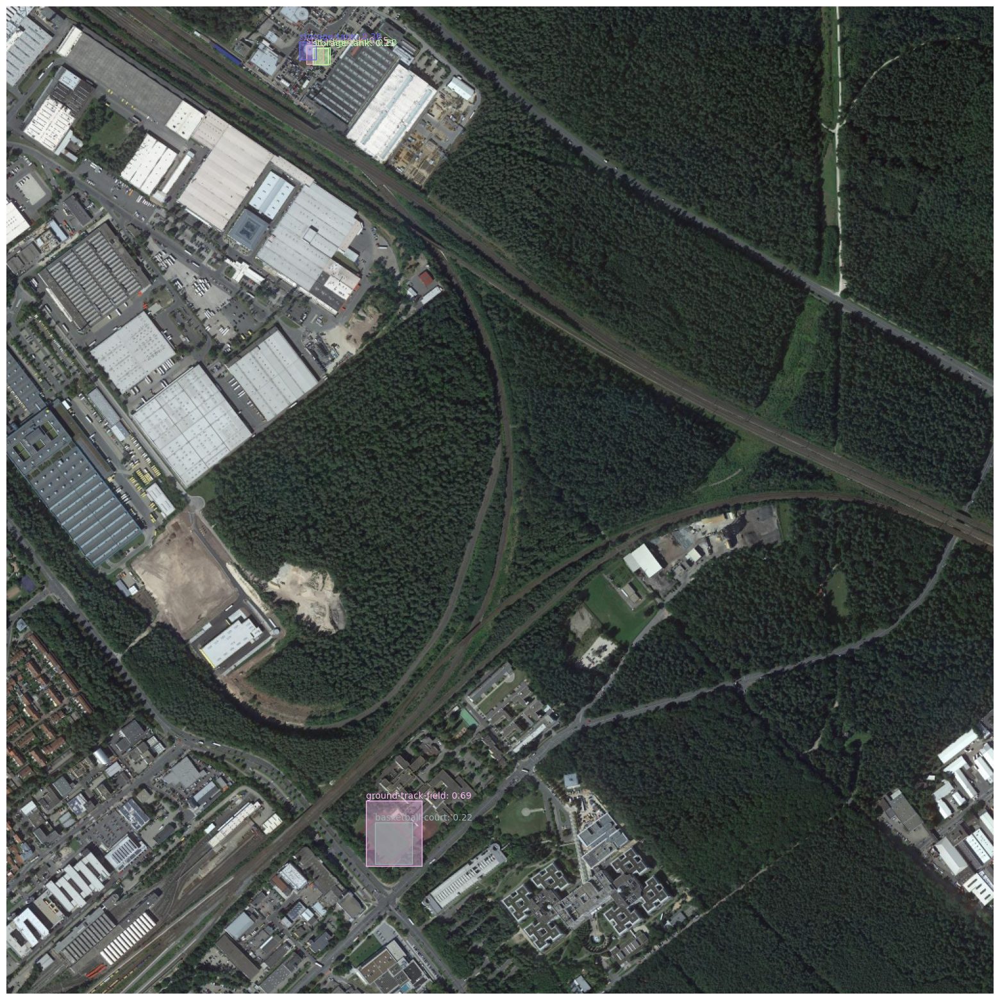

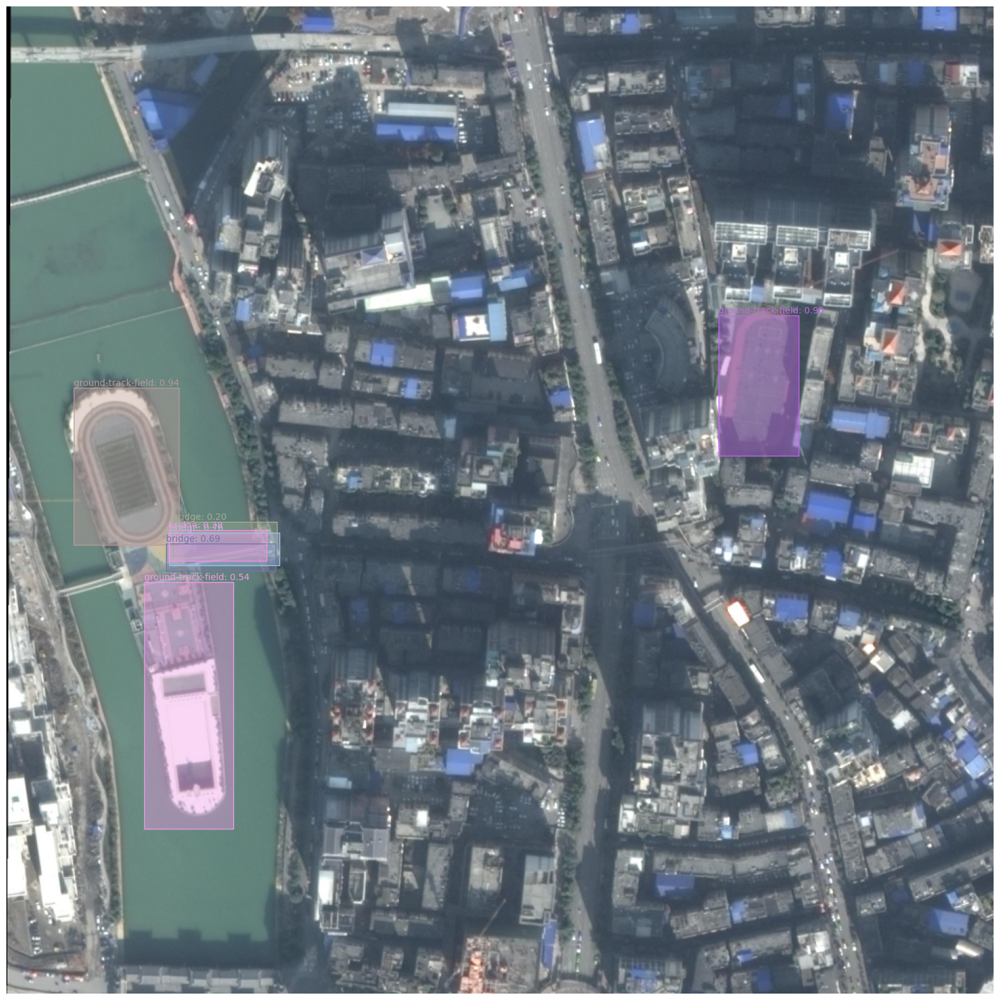

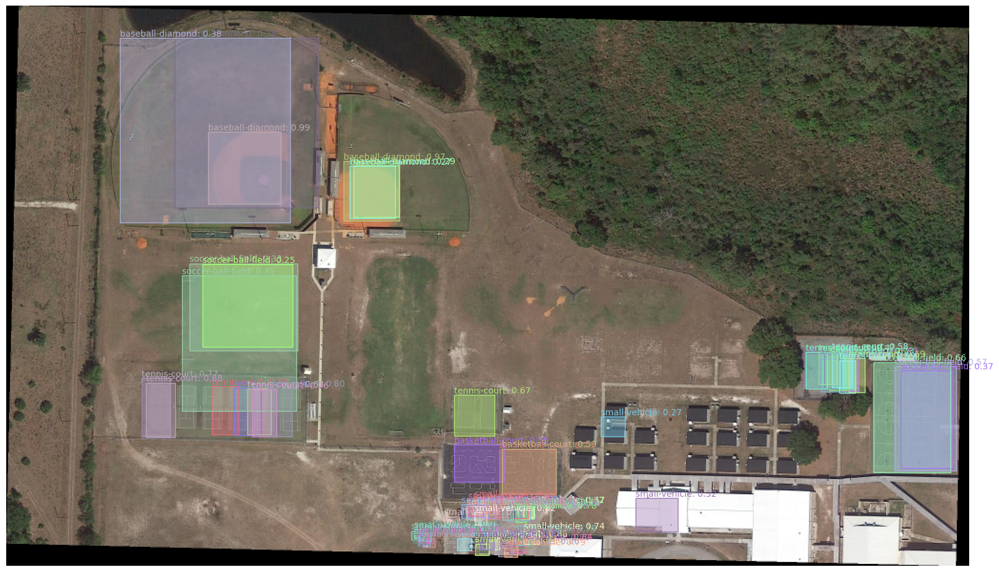

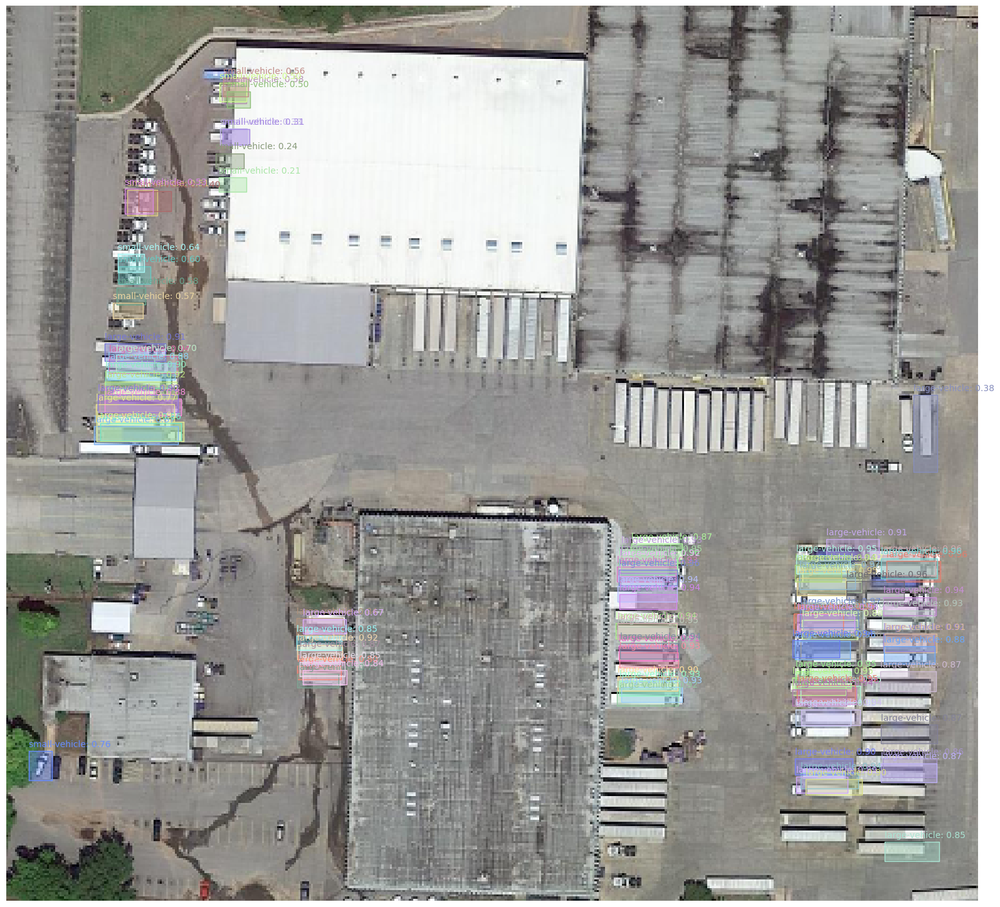

In [ ]:
import os
from PIL import Image

train_images = os.listdir(os.path.join(ROOT, 'val2017'))
for i in range(5, 10):
    img_name = os.path.join(ROOT + '/val2017', train_images[i])
    im = Image.open(img_name)

    show_predictions(im, model)